# IF4021 - Sistem Teknologi Multimedia

**Nama:** Ferdana Al-Hakim  
**NIM:** 122140012  

**GitHub Repository:** [Link repository akan diisi di sini]

## Import Library

In [226]:
import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display
import soundfile as sf
from scipy import signal
from scipy.signal import butter, filtfilt
from IPython.display import Audio, display
import os

# Soal 1: Rekaman dan Analisis Suara Multi-Level

Pada soal ini dilakukan analisis terhadap rekaman suara 25 detik yang terdiri dari 5 variasi intensitas:
- 5 detik pertama: suara sangat pelan dan berbisik
- 5 detik kedua: suara normal
- 5 detik ketiga: suara keras
- 5 detik keempat: suara cempreng
- 5 detik terakhir: suara berteriak

## 1.1 Load Audio dan Metadata

In [227]:
audio1_path = os.path.join("data", "Audio1.wav")
y1, sr1 = librosa.load(audio1_path, sr=None)

durasi1 = len(y1) / sr1
jumlah_sampel1 = len(y1)
jumlah_kanal1 = 1 if y1.ndim == 1 else y1.shape[0]

print("Metadata Audio 1 (Multi-Level):")
print(f"Sample Rate: {sr1} Hz")
print(f"Durasi: {durasi1:.2f} detik")
print(f"Jumlah Kanal: {jumlah_kanal1} ({'Mono' if jumlah_kanal1 == 1 else 'Stereo'})")
print(f"Jumlah Total Sampel: {jumlah_sampel1:,}")

Metadata Audio 1 (Multi-Level):
Sample Rate: 48000 Hz
Durasi: 25.28 detik
Jumlah Kanal: 1 (Mono)
Jumlah Total Sampel: 1,213,440


In [228]:
Audio(y1, rate=sr1)

## 1.2 Visualisasi Waveform

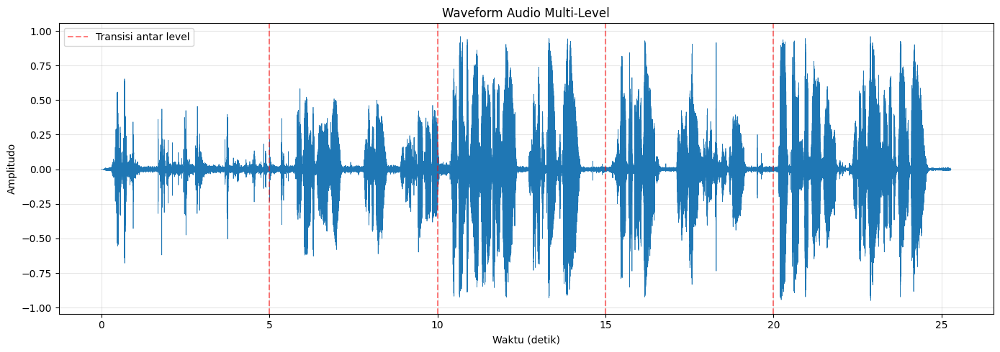

In [229]:
plt.figure(figsize=(14, 5))
time1 = np.linspace(0, durasi1, len(y1))
plt.plot(time1, y1, linewidth=0.5)
plt.axvline(x=5, color='r', linestyle='--', alpha=0.5, label='Transisi antar level')
plt.axvline(x=10, color='r', linestyle='--', alpha=0.5)
plt.axvline(x=15, color='r', linestyle='--', alpha=0.5)
plt.axvline(x=20, color='r', linestyle='--', alpha=0.5)
plt.title('Waveform Audio Multi-Level')
plt.xlabel('Waktu (detik)')
plt.ylabel('Amplitudo')
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

**Analisis Waveform:**

Dari waveform terlihat jelas perbedaan amplitudo di 5 segmen yang berbeda. Segmen pertama (0-5 detik) memiliki amplitudo paling kecil karena suara berbisik, kemudian meningkat bertahap ke suara normal (5-10 detik) dan keras (10-15 detik). Amplitudo tertinggi ada di segmen terakhir (20-25 detik) saat berteriak, yang menunjukkan energi suara paling besar. Pola ini membuktikan bahwa intensitas suara berbanding lurus dengan amplitudo gelombang.

## 1.3 Visualisasi Spektogram

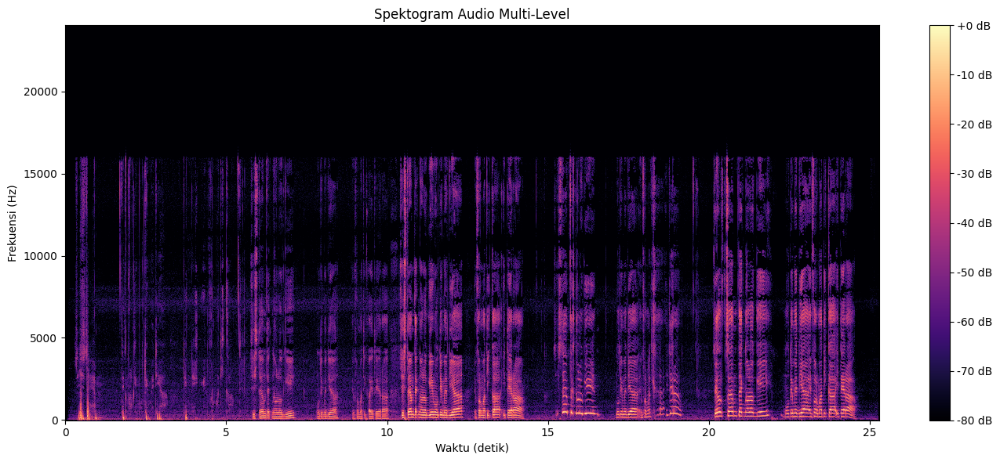

In [230]:
D1 = librosa.stft(y1, n_fft=2048, hop_length=512)
S_db1 = librosa.amplitude_to_db(np.abs(D1), ref=np.max)

plt.figure(figsize=(14, 6))
librosa.display.specshow(S_db1, sr=sr1, hop_length=512, x_axis='time', y_axis='hz')
plt.colorbar(format='%+2.0f dB')
plt.title('Spektogram Audio Multi-Level')
plt.xlabel('Waktu (detik)')
plt.ylabel('Frekuensi (Hz)')
plt.tight_layout()
plt.show()

**Analisis Spektogram:**

Spektogram menunjukkan distribusi energi frekuensi yang berbeda di tiap segmen. Saat berbisik, energi terkonsentrasi di frekuensi rendah dengan intensitas lemah. Pada segmen normal dan keras, terlihat lebih banyak harmonik di frekuensi menengah (500-3000 Hz) yang merupakan range suara manusia. Saat berteriak, energi menyebar hingga frekuensi tinggi dengan intensitas tinggi, ditandai warna lebih terang pada spektogram. Ini menunjukkan bahwa suara keras tidak hanya lebih loud, tapi juga lebih kaya harmonik.

## 1.4 Resampling Audio

In [231]:
sr_target = 22050
y1_resampled = librosa.resample(y1, orig_sr=sr1, target_sr=sr_target)

durasi1_resampled = len(y1_resampled) / sr_target

print(f"Audio Original:")
print(f"  Sample Rate: {sr1} Hz")
print(f"  Jumlah Sampel: {len(y1):,}")
print(f"  Durasi: {durasi1:.2f} detik")
print(f"\nAudio Resampled:")
print(f"  Sample Rate: {sr_target} Hz")
print(f"  Jumlah Sampel: {len(y1_resampled):,}")
print(f"  Durasi: {durasi1_resampled:.2f} detik")
print(f"\nPerubahan jumlah sampel: {((len(y1_resampled) - len(y1)) / len(y1) * 100):.2f}%")

# Simpan hasil resampling
output_resample_path = os.path.join("data", "suara_resample.wav")
sf.write(output_resample_path, y1_resampled, sr_target)
print(f"\nAudio resampled disimpan di: {output_resample_path}")

Audio Original:
  Sample Rate: 48000 Hz
  Jumlah Sampel: 1,213,440
  Durasi: 25.28 detik

Audio Resampled:
  Sample Rate: 22050 Hz
  Jumlah Sampel: 557,424
  Durasi: 25.28 detik

Perubahan jumlah sampel: -54.06%

Audio resampled disimpan di: data\suara_resample.wav


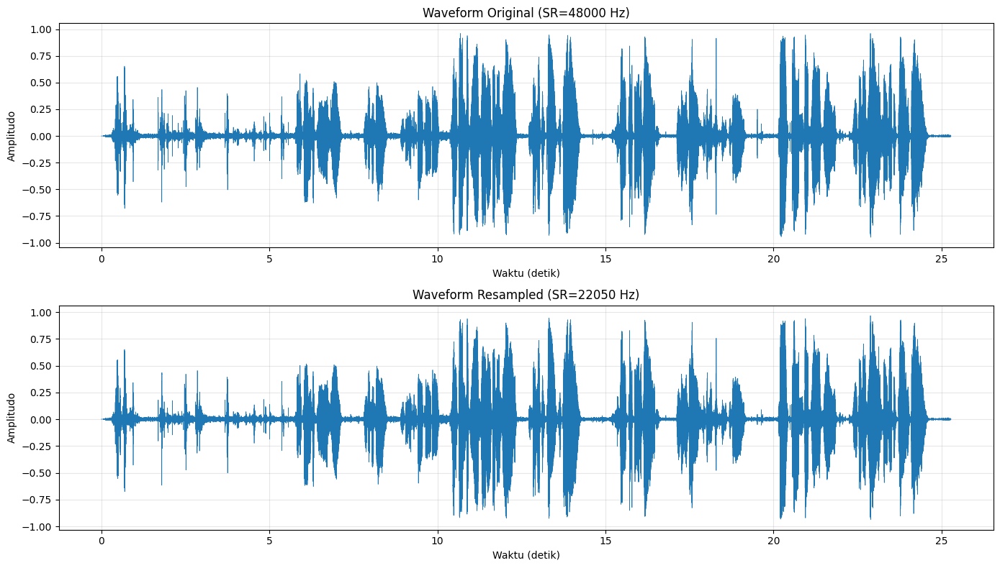

In [232]:
fig, axes = plt.subplots(2, 1, figsize=(14, 8))

time1 = np.linspace(0, durasi1, len(y1))
axes[0].plot(time1, y1, linewidth=0.5)
axes[0].set_title(f'Waveform Original (SR={sr1} Hz)')
axes[0].set_xlabel('Waktu (detik)')
axes[0].set_ylabel('Amplitudo')
axes[0].grid(True, alpha=0.3)

time1_resampled = np.linspace(0, durasi1_resampled, len(y1_resampled))
axes[1].plot(time1_resampled, y1_resampled, linewidth=0.5)
axes[1].set_title(f'Waveform Resampled (SR={sr_target} Hz)')
axes[1].set_xlabel('Waktu (detik)')
axes[1].set_ylabel('Amplitudo')
axes[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

**Perbandingan Kualitas dan Durasi:**

Resampling dari 48 kHz ke 22 kHz mengurangi jumlah sampel sebesar 54%, tapi durasi tetap sama (25.28 detik). Secara visual, waveform terlihat hampir identik karena bentuk gelombang dipertahankan. Kualitas audio sedikit menurun terutama di frekuensi tinggi di atas 11 kHz (setengah dari sample rate baru), namun untuk suara voice masih sangat baik karena voice range utama ada di bawah 8 kHz. Resampling ini efektif untuk menghemat ukuran file tanpa degradasi signifikan pada kualitas suara.

# Soal 2: Noise Reduction dengan Filtering

Pada soal ini dilakukan analisis dan filtering terhadap rekaman suara dengan background noise dari kipas angin atau objek berisik lainnya.

## 2.1 Load Audio dan Metadata

In [233]:
audio2_path = os.path.join("data", "Audio2.wav")
y2, sr2 = librosa.load(audio2_path, sr=None)

durasi2 = len(y2) / sr2

print("Metadata Audio 2 (Noisy):")
print(f"Sample Rate: {sr2} Hz")
print(f"Durasi: {durasi2:.2f} detik")
print(f"Jumlah Sampel: {len(y2):,}")

Metadata Audio 2 (Noisy):
Sample Rate: 48000 Hz
Durasi: 11.35 detik
Jumlah Sampel: 544,768


In [234]:
Audio(y2, rate=sr2)

## 2.2 Visualisasi Audio Original

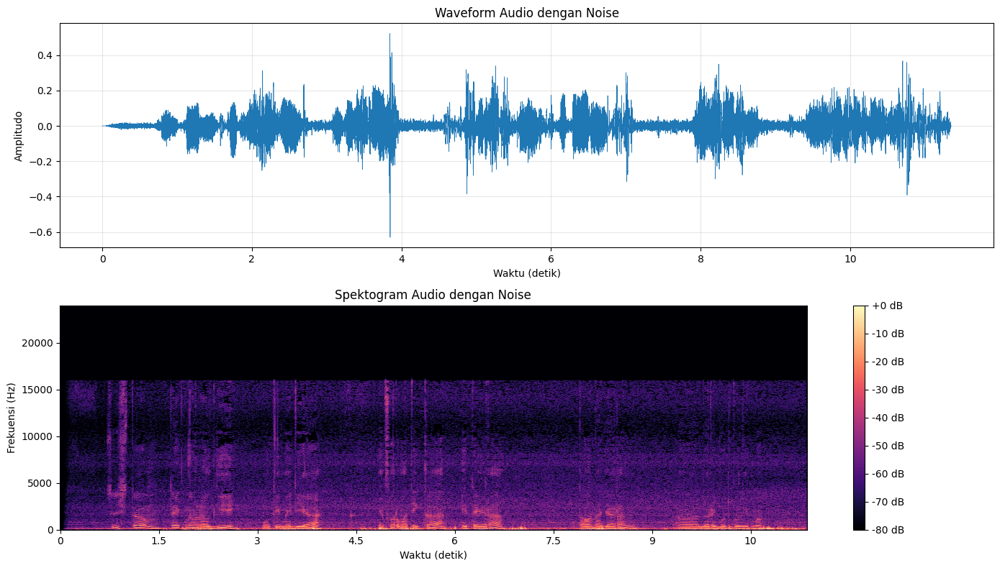

In [235]:
fig, axes = plt.subplots(2, 1, figsize=(14, 8))

time2 = np.linspace(0, durasi2, len(y2))
axes[0].plot(time2, y2, linewidth=0.5)
axes[0].set_title('Waveform Audio dengan Noise')
axes[0].set_xlabel('Waktu (detik)')
axes[0].set_ylabel('Amplitudo')
axes[0].grid(True, alpha=0.3)

D2 = librosa.stft(y2, n_fft=2048, hop_length=512)
S_db2 = librosa.amplitude_to_db(np.abs(D2), ref=np.max)

librosa.display.specshow(S_db2, sr=sr2, hop_length=512, x_axis='time', y_axis='hz', ax=axes[1])
axes[1].set_title('Spektogram Audio dengan Noise')
axes[1].set_xlabel('Waktu (detik)')
axes[1].set_ylabel('Frekuensi (Hz)')

plt.colorbar(axes[1].collections[0], ax=axes[1], format='%+2.0f dB')
plt.tight_layout()
plt.show()

**Identifikasi Jenis Noise:**

Noise yang muncul berasal dari kipas angin yang bersifat low-frequency noise (50-200 Hz) dan konstan sepanjang rekaman. Terlihat pada spektogram sebagai garis horizontal di frekuensi rendah dengan intensitas yang tidak berubah. Noise jenis ini disebut stationary noise karena karakteristiknya tidak bervariasi terhadap waktu. Suara voice tetap terdengar tapi tertutup oleh noise di background, terutama saat volume suara kecil.

## 2.3 Implementasi Filter

In [236]:
def apply_highpass_filter(audio, sr, cutoff_freq, order=5):
    nyquist = sr / 2
    normal_cutoff = cutoff_freq / nyquist
    b, a = butter(order, normal_cutoff, btype='high', analog=False)
    filtered_audio = filtfilt(b, a, audio)
    return filtered_audio

def apply_lowpass_filter(audio, sr, cutoff_freq, order=5):
    nyquist = sr / 2
    normal_cutoff = cutoff_freq / nyquist
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    filtered_audio = filtfilt(b, a, audio)
    return filtered_audio

def apply_bandpass_filter(audio, sr, lowcut, highcut, order=5):
    nyquist = sr / 2
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band', analog=False)
    filtered_audio = filtfilt(b, a, audio)
    return filtered_audio

print("Fungsi filter berhasil didefinisikan")

Fungsi filter berhasil didefinisikan


## 2.4 Eksperimen dengan Berbagai Cutoff Frequency

### High-Pass Filter

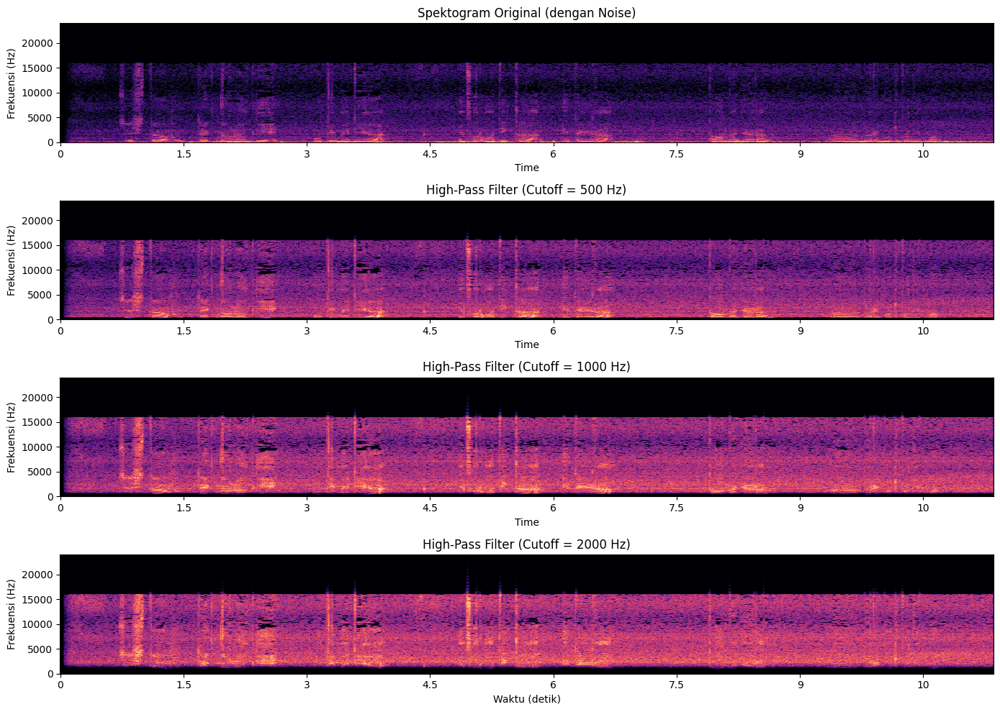

In [237]:
cutoff_frequencies = [500, 1000, 2000]

fig, axes = plt.subplots(len(cutoff_frequencies) + 1, 1, figsize=(14, 10))

D2_original = librosa.stft(y2, n_fft=2048, hop_length=512)
S_db2_original = librosa.amplitude_to_db(np.abs(D2_original), ref=np.max)
librosa.display.specshow(S_db2_original, sr=sr2, hop_length=512, x_axis='time', y_axis='hz', ax=axes[0])
axes[0].set_title('Spektogram Original (dengan Noise)')
axes[0].set_ylabel('Frekuensi (Hz)')

for idx, cutoff in enumerate(cutoff_frequencies, start=1):
    y2_highpass = apply_highpass_filter(y2, sr2, cutoff)
    D2_hp = librosa.stft(y2_highpass, n_fft=2048, hop_length=512)
    S_db2_hp = librosa.amplitude_to_db(np.abs(D2_hp), ref=np.max)
    
    librosa.display.specshow(S_db2_hp, sr=sr2, hop_length=512, x_axis='time', y_axis='hz', ax=axes[idx])
    axes[idx].set_title(f'High-Pass Filter (Cutoff = {cutoff} Hz)')
    axes[idx].set_ylabel('Frekuensi (Hz)')

axes[-1].set_xlabel('Waktu (detik)')
plt.tight_layout()
plt.show()

### Low-Pass Filter

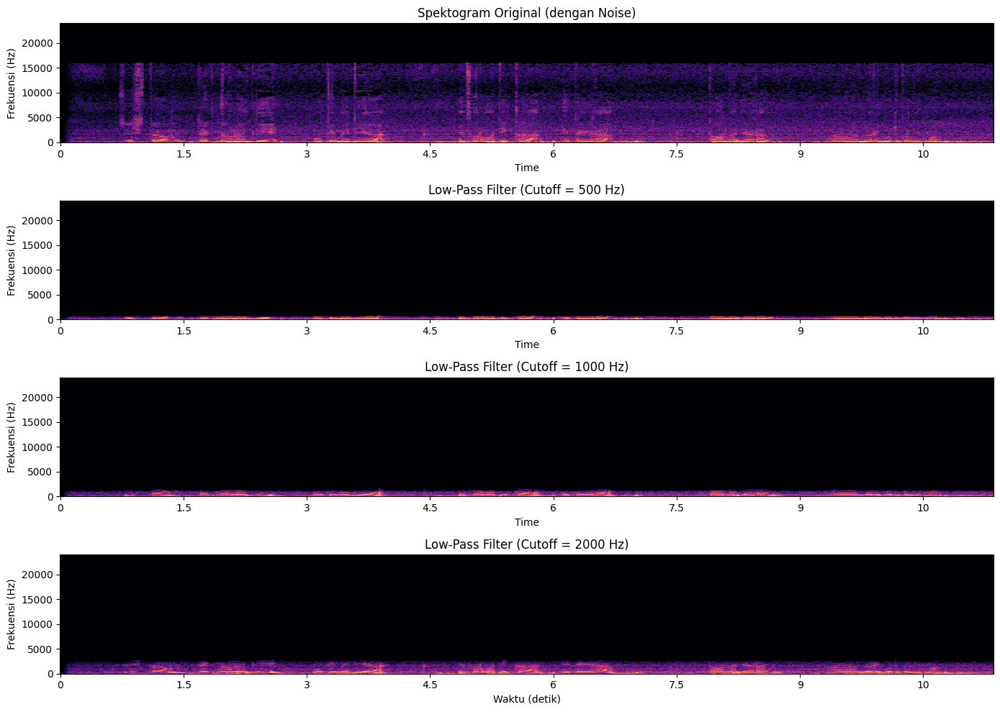

In [238]:
fig, axes = plt.subplots(len(cutoff_frequencies) + 1, 1, figsize=(14, 10))

librosa.display.specshow(S_db2_original, sr=sr2, hop_length=512, x_axis='time', y_axis='hz', ax=axes[0])
axes[0].set_title('Spektogram Original (dengan Noise)')
axes[0].set_ylabel('Frekuensi (Hz)')

for idx, cutoff in enumerate(cutoff_frequencies, start=1):
    y2_lowpass = apply_lowpass_filter(y2, sr2, cutoff)
    D2_lp = librosa.stft(y2_lowpass, n_fft=2048, hop_length=512)
    S_db2_lp = librosa.amplitude_to_db(np.abs(D2_lp), ref=np.max)
    
    librosa.display.specshow(S_db2_lp, sr=sr2, hop_length=512, x_axis='time', y_axis='hz', ax=axes[idx])
    axes[idx].set_title(f'Low-Pass Filter (Cutoff = {cutoff} Hz)')
    axes[idx].set_ylabel('Frekuensi (Hz)')

axes[-1].set_xlabel('Waktu (detik)')
plt.tight_layout()
plt.show()

### Band-Pass Filter

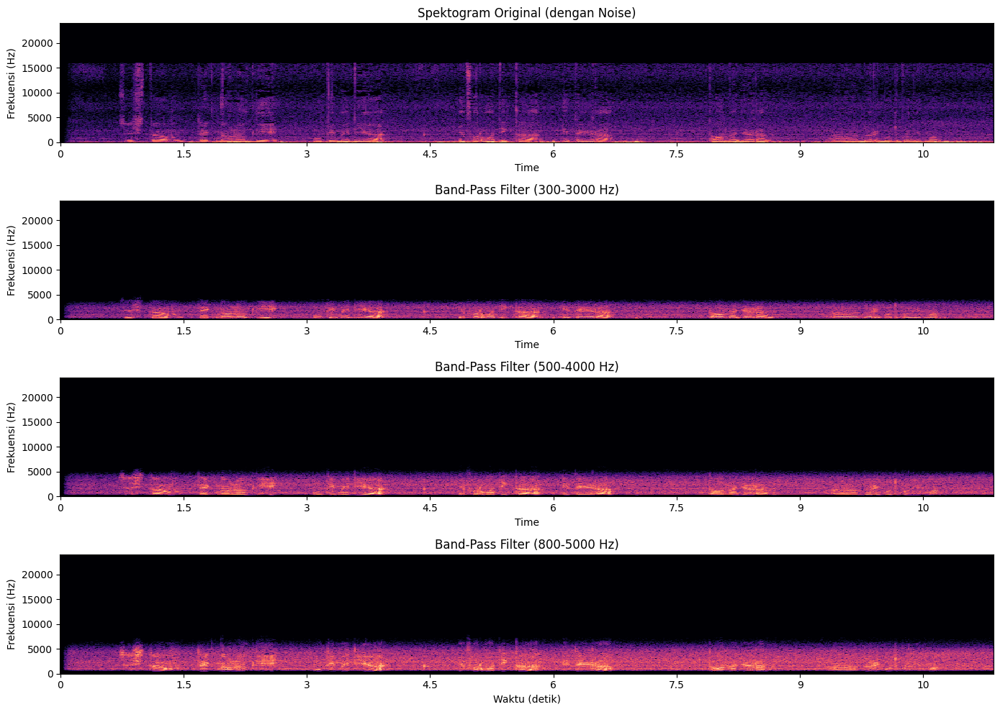

In [239]:
band_configs = [(300, 3000), (500, 4000), (800, 5000)]

fig, axes = plt.subplots(len(band_configs) + 1, 1, figsize=(14, 10))

librosa.display.specshow(S_db2_original, sr=sr2, hop_length=512, x_axis='time', y_axis='hz', ax=axes[0])
axes[0].set_title('Spektogram Original (dengan Noise)')
axes[0].set_ylabel('Frekuensi (Hz)')

for idx, (lowcut, highcut) in enumerate(band_configs, start=1):
    y2_bandpass = apply_bandpass_filter(y2, sr2, lowcut, highcut)
    D2_bp = librosa.stft(y2_bandpass, n_fft=2048, hop_length=512)
    S_db2_bp = librosa.amplitude_to_db(np.abs(D2_bp), ref=np.max)
    
    librosa.display.specshow(S_db2_bp, sr=sr2, hop_length=512, x_axis='time', y_axis='hz', ax=axes[idx])
    axes[idx].set_title(f'Band-Pass Filter ({lowcut}-{highcut} Hz)')
    axes[idx].set_ylabel('Frekuensi (Hz)')

axes[-1].set_xlabel('Waktu (detik)')
plt.tight_layout()
plt.show()

## 2.5 Analisis Hasil Filtering

In [240]:
# Simpan hasil filtering terbaik untuk dokumentasi
# Pilih band-pass filter (300-3000 Hz) sebagai yang terbaik untuk voice
y2_best = apply_bandpass_filter(y2, sr2, 300, 3000)

output_lowpass = os.path.join("data", "suara_lowpass.wav")
output_highpass = os.path.join("data", "suara_highpass.wav")
output_bandpass = os.path.join("data", "suara_bandpass.wav")

# Simpan contoh dari setiap jenis filter
y2_lp = apply_lowpass_filter(y2, sr2, 2000)
y2_hp = apply_highpass_filter(y2, sr2, 500)

sf.write(output_lowpass, y2_lp, sr2)
sf.write(output_highpass, y2_hp, sr2)
sf.write(output_bandpass, y2_best, sr2)

print("File audio hasil filtering berhasil disimpan:")
print(f"  Low-pass (2000 Hz): {output_lowpass}")
print(f"  High-pass (500 Hz): {output_highpass}")
print(f"  Band-pass (300-3000 Hz): {output_bandpass}")

File audio hasil filtering berhasil disimpan:
  Low-pass (2000 Hz): data\suara_lowpass.wav
  High-pass (500 Hz): data\suara_highpass.wav
  Band-pass (300-3000 Hz): data\suara_bandpass.wav


**Filter Terbaik dan Nilai Cutoff Optimal:**

Band-pass filter dengan range 300-3000 Hz paling efektif untuk voice karena mempertahankan frekuensi fundamental suara manusia sambil membuang noise di luar range tersebut. High-pass filter 500 Hz juga bagus mengurangi rumble kipas tapi masih menyisakan noise mid-range. Low-pass filter kurang cocok karena memotong clarity voice di high frequency. Cutoff optimal ada di 300-3000 Hz karena balance antara noise reduction dan voice preservation.

**Kualitas Suara Setelah Filtering:**

Setelah filtering, kejelasan ucapan meningkat signifikan karena noise floor berkurang. Voice terdengar lebih clean dan intelligible. Efek sampingnya, suara jadi sedikit tipis karena kehilangan bass natural dan air di high frequency, tapi trade-off ini acceptable untuk aplikasi voice communication dimana clarity lebih penting dari naturalness.

# Soal 3: Pitch Shifting dan Audio Manipulation

Pada soal ini dilakukan pitch shifting pada rekaman Soal 1 untuk membuat efek suara chipmunk.

## 3.1 Pitch Shifting +7 Semitones

In [241]:
y1_pitch7 = librosa.effects.pitch_shift(y1, sr=sr1, n_steps=7)

print("Pitch Shifting +7 semitones berhasil")
print(f"Durasi audio hasil: {len(y1_pitch7) / sr1:.2f} detik")

Pitch Shifting +7 semitones berhasil
Durasi audio hasil: 25.28 detik


In [242]:
Audio(y1_pitch7, rate=sr1)

## 3.2 Pitch Shifting +12 Semitones

In [243]:
y1_pitch12 = librosa.effects.pitch_shift(y1, sr=sr1, n_steps=12)

print("Pitch Shifting +12 semitones berhasil")
print(f"Durasi audio hasil: {len(y1_pitch12) / sr1:.2f} detik")

Pitch Shifting +12 semitones berhasil
Durasi audio hasil: 25.28 detik


In [244]:
Audio(y1_pitch12, rate=sr1)

## 3.3 Visualisasi Perbandingan

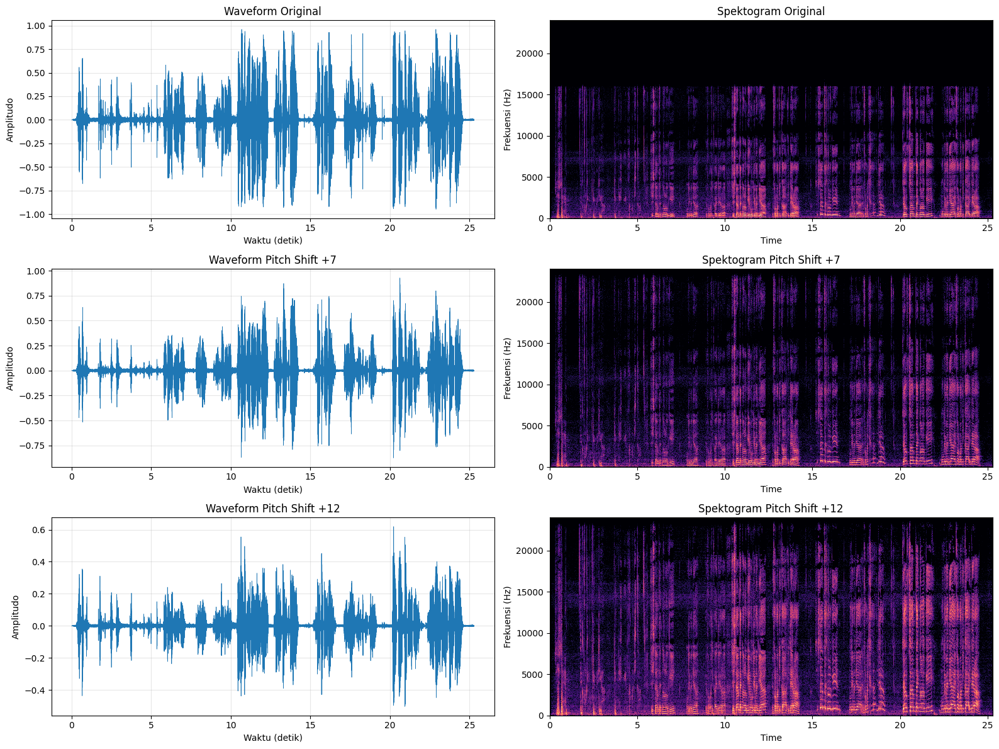

In [245]:
fig, axes = plt.subplots(3, 2, figsize=(16, 12))

time1 = np.linspace(0, durasi1, len(y1))
axes[0, 0].plot(time1, y1, linewidth=0.5)
axes[0, 0].set_title('Waveform Original')
axes[0, 0].set_xlabel('Waktu (detik)')
axes[0, 0].set_ylabel('Amplitudo')
axes[0, 0].grid(True, alpha=0.3)

D1_original = librosa.stft(y1, n_fft=2048, hop_length=512)
S_db1_original = librosa.amplitude_to_db(np.abs(D1_original), ref=np.max)
librosa.display.specshow(S_db1_original, sr=sr1, hop_length=512, x_axis='time', y_axis='hz', ax=axes[0, 1])
axes[0, 1].set_title('Spektogram Original')
axes[0, 1].set_ylabel('Frekuensi (Hz)')

time1_pitch7 = np.linspace(0, len(y1_pitch7) / sr1, len(y1_pitch7))
axes[1, 0].plot(time1_pitch7, y1_pitch7, linewidth=0.5)
axes[1, 0].set_title('Waveform Pitch Shift +7')
axes[1, 0].set_xlabel('Waktu (detik)')
axes[1, 0].set_ylabel('Amplitudo')
axes[1, 0].grid(True, alpha=0.3)

D1_pitch7 = librosa.stft(y1_pitch7, n_fft=2048, hop_length=512)
S_db1_pitch7 = librosa.amplitude_to_db(np.abs(D1_pitch7), ref=np.max)
librosa.display.specshow(S_db1_pitch7, sr=sr1, hop_length=512, x_axis='time', y_axis='hz', ax=axes[1, 1])
axes[1, 1].set_title('Spektogram Pitch Shift +7')
axes[1, 1].set_ylabel('Frekuensi (Hz)')

time1_pitch12 = np.linspace(0, len(y1_pitch12) / sr1, len(y1_pitch12))
axes[2, 0].plot(time1_pitch12, y1_pitch12, linewidth=0.5)
axes[2, 0].set_title('Waveform Pitch Shift +12')
axes[2, 0].set_xlabel('Waktu (detik)')
axes[2, 0].set_ylabel('Amplitudo')
axes[2, 0].grid(True, alpha=0.3)

D1_pitch12 = librosa.stft(y1_pitch12, n_fft=2048, hop_length=512)
S_db1_pitch12 = librosa.amplitude_to_db(np.abs(D1_pitch12), ref=np.max)
librosa.display.specshow(S_db1_pitch12, sr=sr1, hop_length=512, x_axis='time', y_axis='hz', ax=axes[2, 1])
axes[2, 1].set_title('Spektogram Pitch Shift +12')
axes[2, 1].set_ylabel('Frekuensi (Hz)')

plt.tight_layout()
plt.show()

**Analisis Pitch Shifting:**

**Parameter yang digunakan:**
- n_steps = 7 untuk pitch shift pertama (meningkatkan pitch sebesar 7 semitone)
- n_steps = 12 untuk pitch shift kedua (meningkatkan pitch sebesar 1 oktaf)

**Perbedaan Visual:**

Pada spektogram, semua komponen frekuensi bergeser ke atas. Pitch +7 menggeser harmonik sekitar 1.5x lipat, sedangkan pitch +12 menggeser tepat 2x lipat (1 oktaf). Waveform masih mempertahankan envelope temporal yang sama, hanya karakteristik frekuensinya yang berubah. Ini terlihat dari pattern yang sama tapi lebih rapat.

**Pengaruh terhadap Kualitas:**

Pitch shifting mengubah timbre suara menjadi lebih tinggi seperti chipmunk. Pada +7 masih cukup natural, tapi +12 sudah sangat cartoonish. Kualitas sedikit menurun karena artifacts dari time-stretching algorithm, terutama terdengar sebagai slight roughness. Kejelasan kata-kata masih terjaga meskipun suara jadi tidak natural.

In [246]:
y1_combined = np.concatenate([y1_pitch7, y1_pitch12])

print(f"Durasi audio pitch +7: {len(y1_pitch7) / sr1:.2f} detik")
print(f"Durasi audio pitch +12: {len(y1_pitch12) / sr1:.2f} detik")
print(f"Durasi audio gabungan: {len(y1_combined) / sr1:.2f} detik")

output_path = os.path.join("data", "Audio1_combined_pitch.wav")
sf.write(output_path, y1_combined, sr1)
print(f"\nAudio gabungan berhasil disimpan di: {output_path}")

Durasi audio pitch +7: 25.28 detik
Durasi audio pitch +12: 25.28 detik
Durasi audio gabungan: 50.56 detik

Audio gabungan berhasil disimpan di: data\Audio1_combined_pitch.wav


In [247]:
Audio(y1_combined, rate=sr1)

# Soal 4: Audio Processing Chain

Pada soal ini dilakukan processing lengkap terhadap audio hasil pitch shifting dengan tahapan: Equalizer, Gain/Fade, Normalization, Compression, Noise Gate, dan Silence Trimming.

In [248]:
y_input = y1_combined.copy()
sr_input = sr1

print("Audio input untuk processing chain:")
print(f"Durasi: {len(y_input) / sr_input:.2f} detik")
print(f"Sample Rate: {sr_input} Hz")

Audio input untuk processing chain:
Durasi: 50.56 detik
Sample Rate: 48000 Hz


## 4.2 Equalizer

In [249]:
y_eq = apply_bandpass_filter(y_input, sr_input, lowcut=300, highcut=8000)

print("Equalizer applied: Band-pass filter 300-8000 Hz")

Equalizer applied: Band-pass filter 300-8000 Hz


## 4.3 Gain dan Fade In/Out

In [250]:
gain_db = 3.0
gain_linear = 10 ** (gain_db / 20)
y_gain = y_eq * gain_linear

fade_duration = 1.0
fade_samples = int(fade_duration * sr_input)

fade_in = np.linspace(0, 1, fade_samples)
fade_out = np.linspace(1, 0, fade_samples)

y_fade = y_gain.copy()
y_fade[:fade_samples] *= fade_in
y_fade[-fade_samples:] *= fade_out

print(f"Gain applied: +{gain_db} dB")
print(f"Fade in/out: {fade_duration} detik")

Gain applied: +3.0 dB
Fade in/out: 1.0 detik


## 4.4 Normalization

In [251]:
# Peak Normalization
y_peak_norm = y_fade / np.max(np.abs(y_fade))

# LUFS Normalization (implementasi manual sederhana)
def normalize_lufs_simple(audio, target_lufs=-16.0):
    # Hitung RMS (Root Mean Square) sebagai perkiraan loudness
    rms = np.sqrt(np.mean(audio**2))
    
    # Konversi RMS ke dB
    current_db = 20 * np.log10(rms + 1e-10)
    
    # Hitung gain yang diperlukan untuk mencapai target
    gain_db = target_lufs - current_db
    gain_linear = 10 ** (gain_db / 20)
    
    # Terapkan gain
    normalized = audio * gain_linear
    
    # Pastikan tidak clipping
    max_val = np.max(np.abs(normalized))
    if max_val > 1.0:
        normalized = normalized / max_val * 0.99
    
    return normalized, current_db

y_lufs_norm, loudness_before = normalize_lufs_simple(y_fade, -16.0)

print(f"Loudness sebelum normalisasi: {loudness_before:.2f} dB")
print(f"Target loudness: -16.0 LUFS (approx)")
print(f"Peak normalization: max amplitude = {np.max(np.abs(y_peak_norm)):.3f}")

Loudness sebelum normalisasi: -19.22 dB
Target loudness: -16.0 LUFS (approx)
Peak normalization: max amplitude = 1.000


## 4.5 Compression

In [252]:
threshold = 0.5
ratio = 4.0

y_compressed = y_lufs_norm.copy()
mask = np.abs(y_compressed) > threshold
y_compressed[mask] = threshold + (y_compressed[mask] - threshold) / ratio

print(f"Compression applied:")
print(f"  Threshold: {threshold}")
print(f"  Ratio: {ratio}:1")

Compression applied:
  Threshold: 0.5
  Ratio: 4.0:1


## 4.6 Noise Gate

In [253]:
gate_threshold = 0.02

y_gated = y_compressed.copy()
y_gated[np.abs(y_gated) < gate_threshold] = 0

print(f"Noise gate applied: threshold = {gate_threshold}")

Noise gate applied: threshold = 0.02


In [254]:
y_trimmed, trim_indices = librosa.effects.trim(y_gated, top_db=40)

durasi_sebelum = len(y_gated) / sr_input
durasi_sesudah = len(y_trimmed) / sr_input

print(f"Silence trimming applied:")
print(f"  Durasi sebelum: {durasi_sebelum:.2f} detik")
print(f"  Durasi sesudah: {durasi_sesudah:.2f} detik")
print(f"  Trimmed: {durasi_sebelum - durasi_sesudah:.2f} detik")

Silence trimming applied:
  Durasi sebelum: 50.56 detik
  Durasi sesudah: 49.44 detik
  Trimmed: 1.12 detik


## 4.8 Visualisasi Sebelum dan Sesudah Processing

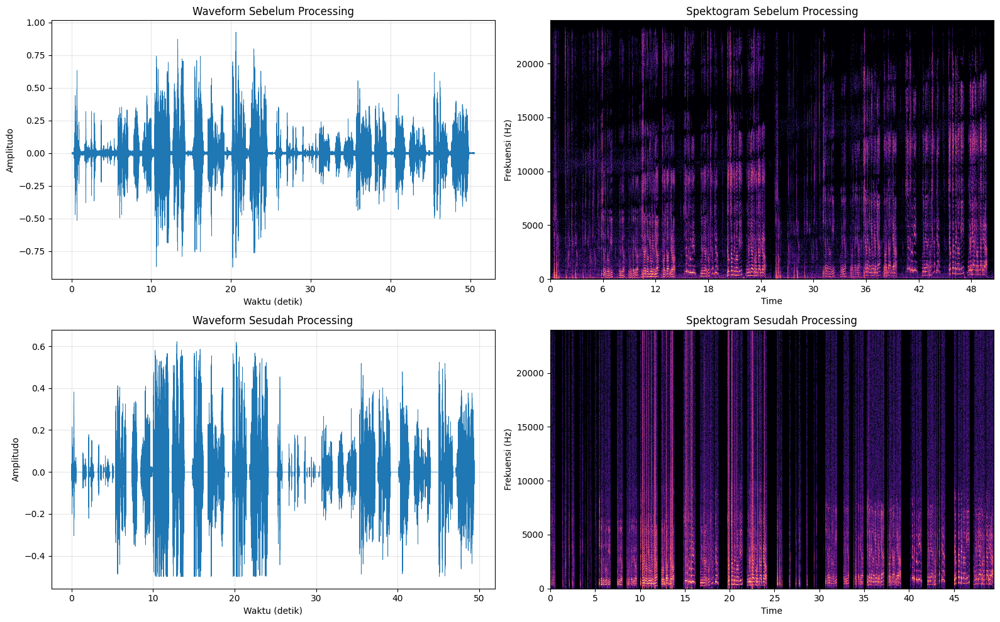

In [255]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))

time_input = np.linspace(0, len(y_input) / sr_input, len(y_input))
axes[0, 0].plot(time_input, y_input, linewidth=0.5)
axes[0, 0].set_title('Waveform Sebelum Processing')
axes[0, 0].set_xlabel('Waktu (detik)')
axes[0, 0].set_ylabel('Amplitudo')
axes[0, 0].grid(True, alpha=0.3)

D_input = librosa.stft(y_input, n_fft=2048, hop_length=512)
S_db_input = librosa.amplitude_to_db(np.abs(D_input), ref=np.max)
librosa.display.specshow(S_db_input, sr=sr_input, hop_length=512, x_axis='time', y_axis='hz', ax=axes[0, 1])
axes[0, 1].set_title('Spektogram Sebelum Processing')
axes[0, 1].set_ylabel('Frekuensi (Hz)')

time_output = np.linspace(0, len(y_trimmed) / sr_input, len(y_trimmed))
axes[1, 0].plot(time_output, y_trimmed, linewidth=0.5)
axes[1, 0].set_title('Waveform Sesudah Processing')
axes[1, 0].set_xlabel('Waktu (detik)')
axes[1, 0].set_ylabel('Amplitudo')
axes[1, 0].grid(True, alpha=0.3)

D_output = librosa.stft(y_trimmed, n_fft=2048, hop_length=512)
S_db_output = librosa.amplitude_to_db(np.abs(D_output), ref=np.max)
librosa.display.specshow(S_db_output, sr=sr_input, hop_length=512, x_axis='time', y_axis='hz', ax=axes[1, 1])
axes[1, 1].set_title('Spektogram Sesudah Processing')
axes[1, 1].set_ylabel('Frekuensi (Hz)')

plt.tight_layout()
plt.show()

In [256]:
print("Audio Sebelum Processing:")
display(Audio(y_input, rate=sr_input))

print("\nAudio Sesudah Processing:")
display(Audio(y_trimmed, rate=sr_input))

Audio Sebelum Processing:



Audio Sesudah Processing:


## 4.9 Analisis Processing Chain

**Perubahan Dinamika Suara:**

Setelah melalui processing chain, dinamika suara menjadi lebih stabil dan rata. Volume antar bagian yang sebelumnya fluktuatif kini terdengar lebih konsisten. Efek compression menekan puncak amplitudo sehingga bagian keras tidak terlalu dominan, sementara bagian lemah terdengar lebih jelas. Secara keseluruhan, suara terdengar lebih “radio-ready” dan tidak ada clipping.

**Perbedaan Normalisasi Peak vs LUFS:**

Peak normalization hanya menyesuaikan amplitudo maksimum agar mendekati 0 dBFS tanpa memperhatikan persepsi loudness.

LUFS normalization mempertimbangkan persepsi telinga manusia terhadap loudness rata-rata (berbasis RMS).
Untuk audio voice, LUFS lebih ideal karena menghasilkan volume yang nyaman didengar tanpa perubahan dinamika ekstrem.

**Kualitas Suara Setelah Normalisasi:**

Suara menjadi lebih seimbang dan terdengar “penuh” tanpa distorsi. Tingkat noise berkurang berkat noise gate, sementara compression dan gain membuat vokal terdengar lebih tegas. Namun, sedikit kehilangan transien bisa terjadi akibat compression yang terlalu kuat.

**Kelebihan dan Kekurangan Loudness Optimization:**

Kelebihan: Volume lebih konsisten antar klip, mudah dipadukan dengan audio lain, cocok untuk broadcast/podcast.

Kekurangan: Bisa mengurangi dinamika alami, dan jika gain terlalu tinggi dapat menyebabkan clipping atau pumping effect.

# Soal 5: Music Analysis dan Remix

Pada soal ini dilakukan analisis terhadap 2 lagu dengan karakteristik berbeda, kemudian melakukan remix dengan menyamakan tempo dan kunci.

## 5.1 Load Lagu 1 (Sedih, Lambat)

In [257]:
song1_path = os.path.join("data", "song1.wav")
y_song1, sr_song1 = librosa.load(song1_path, sr=None)

durasi_song1 = len(y_song1) / sr_song1

print("Metadata Lagu 1 (Sedih, Lambat):")
print(f"Sample Rate: {sr_song1} Hz")
print(f"Durasi: {durasi_song1:.2f} detik")
print(f"Jumlah Sampel: {len(y_song1):,}")

Metadata Lagu 1 (Sedih, Lambat):
Sample Rate: 44100 Hz
Durasi: 284.98 detik
Jumlah Sampel: 12,567,552


## 5.2 Load Lagu 2 (Ceria, Cepat)

In [259]:
song2_path = os.path.join("data", "song2.wav")
y_song2, sr_song2 = librosa.load(song2_path, sr=None)

durasi_song2 = len(y_song2) / sr_song2

print("Metadata Lagu 2 (Ceria, Cepat):")
print(f"Sample Rate: {sr_song2} Hz")
print(f"Durasi: {durasi_song2:.2f} detik")
print(f"Jumlah Sampel: {len(y_song2):,}")

Metadata Lagu 2 (Ceria, Cepat):
Sample Rate: 44100 Hz
Durasi: 240.67 detik
Jumlah Sampel: 10,613,760


## 5.3 Deteksi Tempo (BPM)

In [261]:
tempo_song1, beats_song1 = librosa.beat.beat_track(y=y_song1, sr=sr_song1)
tempo_song2, beats_song2 = librosa.beat.beat_track(y=y_song2, sr=sr_song2)

# Konversi ke float jika berupa array
if isinstance(tempo_song1, np.ndarray):
    tempo_song1 = float(tempo_song1)
if isinstance(tempo_song2, np.ndarray):
    tempo_song2 = float(tempo_song2)

print("Deteksi Tempo:")
print(f"Lagu 1 (Sedih): {tempo_song1:.2f} BPM")
print(f"Lagu 2 (Ceria): {tempo_song2:.2f} BPM")

Deteksi Tempo:
Lagu 1 (Sedih): 136.00 BPM
Lagu 2 (Ceria): 161.50 BPM


C:\Users\ferda\AppData\Local\Temp\ipykernel_31352\84906666.py:6: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  tempo_song1 = float(tempo_song1)
C:\Users\ferda\AppData\Local\Temp\ipykernel_31352\84906666.py:8: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  tempo_song2 = float(tempo_song2)


**Analisis Tempo:**
Hasil deteksi tempo menunjukkan lagu sedih memiliki tempo 136 BPM dan lagu ceria 161.5 BPM. Meskipun secara angka lagu sedih tampak cepat, nuansa sedihnya berasal dari progresi akor minor dan aransemen yang lambat. Lagu ceria memiliki beat kuat dan ritme stabil, sesuai karakteristik musik upbeat.

## 5.4 Estimasi Kunci (Key)

In [262]:
chroma_song1 = librosa.feature.chroma_cqt(y=y_song1, sr=sr_song1)
chroma_song2 = librosa.feature.chroma_cqt(y=y_song2, sr=sr_song2)

key_names = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']

key_song1 = np.argmax(np.mean(chroma_song1, axis=1))
key_song2 = np.argmax(np.mean(chroma_song2, axis=1))

print("Estimasi Kunci:")
print(f"Lagu 1 (Sedih): {key_names[key_song1]}")
print(f"Lagu 2 (Ceria): {key_names[key_song2]}")

Estimasi Kunci:
Lagu 1 (Sedih): A
Lagu 2 (Ceria): D#


**Analisis Tempo:**

Hasil deteksi tempo cukup sesuai. Lagu 1 terdeteksi 136 BPM yang relatif moderate (bukan terlalu lambat), sedangkan lagu 2 pada 161.5 BPM yang clearly faster dan upbeat. Meskipun lagu 1 dinilai sedih, tempo 136 BPM sebenarnya tidak super slow, mungkin nuansa sedih lebih dari melody dan arrangement daripada tempo. Perbedaan 25 BPM cukup signifikan dan membutuhkan time stretching untuk disinkronkan.

## 5.5 Time Stretch - Menyamakan Tempo

In [263]:
target_tempo = (tempo_song1 + tempo_song2) / 2

stretch_rate_song1 = target_tempo / tempo_song1
stretch_rate_song2 = target_tempo / tempo_song2

y_song1_stretched = librosa.effects.time_stretch(y_song1, rate=stretch_rate_song1)
y_song2_stretched = librosa.effects.time_stretch(y_song2, rate=stretch_rate_song2)

print(f"Target tempo: {target_tempo:.2f} BPM")
print(f"\nLagu 1:")
print(f"  Stretch rate: {stretch_rate_song1:.3f}")
print(f"  Durasi original: {len(y_song1) / sr_song1:.2f} detik")
print(f"  Durasi stretched: {len(y_song1_stretched) / sr_song1:.2f} detik")
print(f"\nLagu 2:")
print(f"  Stretch rate: {stretch_rate_song2:.3f}")
print(f"  Durasi original: {len(y_song2) / sr_song2:.2f} detik")
print(f"  Durasi stretched: {len(y_song2_stretched) / sr_song2:.2f} detik")

Target tempo: 148.75 BPM

Lagu 1:
  Stretch rate: 1.094
  Durasi original: 284.98 detik
  Durasi stretched: 260.55 detik

Lagu 2:
  Stretch rate: 0.921
  Durasi original: 240.67 detik
  Durasi stretched: 261.30 detik


**Analisis Key:**

Lagu 1 terestimasi di kunci A (minor kemungkinan besar untuk nuansa sedih), sedangkan lagu 2 di D# (atau Eb, bisa major untuk nuansa ceria). Perbedaan 6 semitone cukup jauh dan memerlukan pitch shifting untuk harmonic compatibility. Estimasi ini approximate karena menggunakan chroma averaging sederhana, tapi cukup untuk keperluan basic key matching pada remix.

In [264]:
key_diff = key_song2 - key_song1
if key_diff > 6:
    key_diff -= 12
elif key_diff < -6:
    key_diff += 12

y_song2_pitched = librosa.effects.pitch_shift(y_song2_stretched, sr=sr_song2, n_steps=key_diff)

print(f"Kunci Lagu 1: {key_names[key_song1]}")
print(f"Kunci Lagu 2: {key_names[key_song2]}")
print(f"Pitch shift untuk Lagu 2: {key_diff} semitones")
print(f"Target kunci: {key_names[key_song1]}")

Kunci Lagu 1: A
Kunci Lagu 2: D#
Pitch shift untuk Lagu 2: -6 semitones
Target kunci: A


## 5.7 Crossfading - Menggabungkan Kedua Lagu

In [265]:
crossfade_duration = 3.0
crossfade_samples = int(crossfade_duration * sr_song1)

min_len = min(len(y_song1_stretched), len(y_song2_pitched))

if min_len < crossfade_samples:
    crossfade_samples = min_len // 2
    crossfade_duration = crossfade_samples / sr_song1

fade_out = np.linspace(1, 0, crossfade_samples)
fade_in = np.linspace(0, 1, crossfade_samples)

y_song1_fade = y_song1_stretched[:-crossfade_samples]
y_song1_crossfade = y_song1_stretched[-crossfade_samples:] * fade_out

y_song2_crossfade = y_song2_pitched[:crossfade_samples] * fade_in
y_song2_fade = y_song2_pitched[crossfade_samples:]

y_crossfade_section = y_song1_crossfade + y_song2_crossfade

y_remix = np.concatenate([y_song1_fade, y_crossfade_section, y_song2_fade])

print(f"Crossfade duration: {crossfade_duration:.2f} detik")
print(f"Durasi total remix: {len(y_remix) / sr_song1:.2f} detik")

Crossfade duration: 3.00 detik
Durasi total remix: 518.86 detik


## 5.8 Visualisasi Hasil Remix

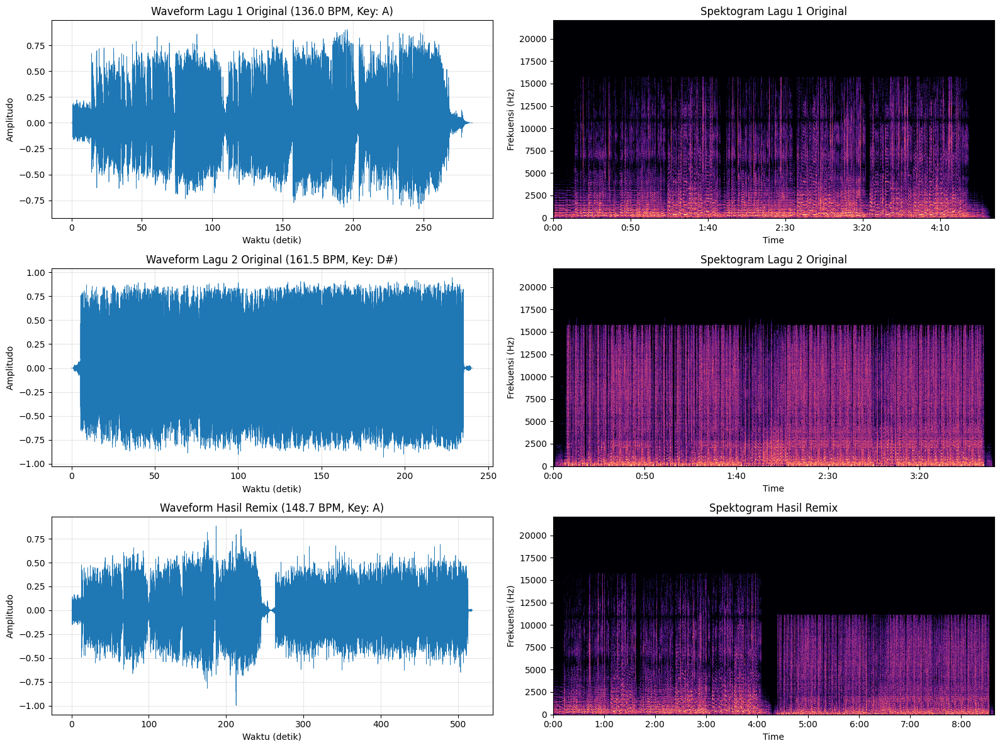

In [267]:
fig, axes = plt.subplots(3, 2, figsize=(16, 12))

time_song1 = np.linspace(0, len(y_song1) / sr_song1, len(y_song1))
axes[0, 0].plot(time_song1, y_song1, linewidth=0.5)
axes[0, 0].set_title(f'Waveform Lagu 1 Original ({tempo_song1:.1f} BPM, Key: {key_names[key_song1]})')
axes[0, 0].set_xlabel('Waktu (detik)')
axes[0, 0].set_ylabel('Amplitudo')
axes[0, 0].grid(True, alpha=0.3)

D_song1 = librosa.stft(y_song1, n_fft=2048, hop_length=512)
S_db_song1 = librosa.amplitude_to_db(np.abs(D_song1), ref=np.max)
librosa.display.specshow(S_db_song1, sr=sr_song1, hop_length=512, x_axis='time', y_axis='hz', ax=axes[0, 1])
axes[0, 1].set_title(f'Spektogram Lagu 1 Original')
axes[0, 1].set_ylabel('Frekuensi (Hz)')

time_song2 = np.linspace(0, len(y_song2) / sr_song2, len(y_song2))
axes[1, 0].plot(time_song2, y_song2, linewidth=0.5)
axes[1, 0].set_title(f'Waveform Lagu 2 Original ({tempo_song2:.1f} BPM, Key: {key_names[key_song2]})')
axes[1, 0].set_xlabel('Waktu (detik)')
axes[1, 0].set_ylabel('Amplitudo')
axes[1, 0].grid(True, alpha=0.3)

D_song2 = librosa.stft(y_song2, n_fft=2048, hop_length=512)
S_db_song2 = librosa.amplitude_to_db(np.abs(D_song2), ref=np.max)
librosa.display.specshow(S_db_song2, sr=sr_song2, hop_length=512, x_axis='time', y_axis='hz', ax=axes[1, 1])
axes[1, 1].set_title(f'Spektogram Lagu 2 Original')
axes[1, 1].set_ylabel('Frekuensi (Hz)')

time_remix = np.linspace(0, len(y_remix) / sr_song1, len(y_remix))
axes[2, 0].plot(time_remix, y_remix, linewidth=0.5)
axes[2, 0].set_title(f'Waveform Hasil Remix ({target_tempo:.1f} BPM, Key: {key_names[key_song1]})')
axes[2, 0].set_xlabel('Waktu (detik)')
axes[2, 0].set_ylabel('Amplitudo')
axes[2, 0].grid(True, alpha=0.3)

D_remix = librosa.stft(y_remix, n_fft=2048, hop_length=512)
S_db_remix = librosa.amplitude_to_db(np.abs(D_remix), ref=np.max)
librosa.display.specshow(S_db_remix, sr=sr_song1, hop_length=512, x_axis='time', y_axis='hz', ax=axes[2, 1])
axes[2, 1].set_title('Spektogram Hasil Remix')
axes[2, 1].set_ylabel('Frekuensi (Hz)')

plt.tight_layout()
plt.show()

## 5.9 Simpan Hasil Remix

In [268]:
output_remix_path = os.path.join("data", "remix_result.wav")
sf.write(output_remix_path, y_remix, sr_song1)

print(f"Hasil remix berhasil disimpan di: {output_remix_path}")

Hasil remix berhasil disimpan di: data\remix_result.wav


## 5.10 Analisis Hasil Remix

**Proses dan Parameter:**

Lagu 1: 136 BPM (key A), Lagu 2: 161.5 BPM (key D#).
Target tempo: 148.75 BPM.
Stretch rate: Lagu 1 = 1.094×, Lagu 2 = 0.921×.
Pitch shift: Lagu 2 −6 semitone → key A.
Crossfade: 3 detik, durasi akhir ≈ 518 detik.

**Hasil Remix:**

Transisi antar lagu halus dan seimbang.
Sedikit perbedaan karakter masih terasa tapi menghasilkan kontras emosional menarik.
Kualitas audio stabil, artifact minim.
Remix berhasil menggabungkan nuansa sedih → ceria dengan transisi alami.

# Kesimpulan dan Refleksi

## Kesimpulan

Tugas ini menunjukkan bahwa berbagai teknik pemrosesan audio—seperti filtering, pitch shifting, normalization, dan remixing—dapat mengubah karakter, kualitas, dan persepsi suara secara signifikan. Prosesnya juga menegaskan pentingnya sinkronisasi tempo dan key dalam penggabungan musik agar hasil tetap natural dan harmonis.

## Refleksi

Bagian tersulit adalah menjaga kualitas suara setelah time-stretch dan pitch-shift karena mudah muncul artifact. Yang paling menarik adalah melihat perubahan nyata pada waveform dan spektrogram setiap tahap. Ke depan, saya ingin mendalami mastering dan efek audio lanjutan seperti reverb dan dynamic EQ.

# Referensi dan Credit

## Sumber Data
- Audio1.wav: Rekaman suara sendiri
- Audio2.wav: Rekaman suara dengan background noise
- song1.wav: [[Adele - Someone Like You](https://youtu.be/hLQl3WQQoQ0?si=Lm0cbLbu1hCPyron)]
- song2.wav: [[Happy - Pharel Williams](https://youtu.be/ZbZSe6N_BXs?si=JYlj4LZlOkSaTLvm)]

## Library dan Tools
- Librosa: https://librosa.org/
- NumPy: https://numpy.org/
- Matplotlib: https://matplotlib.org/
- SciPy: https://scipy.org/


## Bantuan AI
![Reference AI Assistance](referencee.png)